In [ ]:
!pip install tensorflowjs==4.12.0 tensorflow==2.15 keras==2.15

INFO: pip is looking at multiple versions of tensorflow-decision-forests to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of tf-keras to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of tensorstore to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of tensorstore to determine which version is compatible with other requirements. This could take a while.
INFO: This is taking longer than usual. You might need to provide the dependency resolver with stricter constraints to reduce runtime. See https://pip.pypa.io/warnings/backtracking for guidance. If you want to abort this run, press Ctrl + C.
INFO: pip is looking at multiple versions of jax to determine which version is compatible with other requirements. This could take a while.
INFO: p

In [ ]:
!pip install jax==0.4.21 jaxlib==0.4.21

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 26.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 MB 7.0 MB/s eta 0:00:00
  Attempting uninstall: jaxlib
    Found existing installation: jaxlib 0.4.33
    Uninstalling jaxlib-0.4.33:
      Successfully uninstalled jaxlib-0.4.33
  Attempting uninstall: jax
    Found existing installation: jax 0.4.33
    Uninstalling jax-0.4.33:
      Successfully uninstalled jax-0.4.33
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
chex 0.1.87 requires jax>=0.4.27, but you have jax 0.4.21 which is incompatible.
chex 0.1.87 requires jaxlib>=0.4.27, but you have jaxlib 0.4.21 which is incompatible.
flax 0.8.5 requires jax>=0.4.27, but you have jax 0.4.21 which is incompatible.
optax 0.2.4 requires jax>=0.4.27, but you have jax 0.4.21 which is incompatible.
optax 0.2.4 requires jaxlib>=0.4.27, but yo

In [ ]:
!pip install matplotlib-venn

In [ ]:
!apt-get -qq install -y graphviz && pip install pydot
import pydot

In [ ]:
import tensorflowjs as tfjs

In [ ]:
import tensorflow as tf
import keras

print("TensorFlow version:", tf.__version__)
print("Keras version:", keras.__version__)

TensorFlow version: 2.15.0
Keras version: 2.15.0


# Data Preprocessing

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical

import pandas as pd
import numpy as np
import cv2
import os
import zipfile
import shutil
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from shutil import copyfile

In [ ]:
from tensorflow.keras.layers import Rescaling
from tensorflow.keras.layers import Normalization

In [ ]:
# TensorFlow and Keras for Model and Preprocessing
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.layers import Rescaling, Normalization, RandomFlip, RandomRotation
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Dense, BatchNormalization, Dropout
from tensorflow.keras.initializers import GlorotNormal
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.models import Model
from tensorflow import keras
from tensorflow.keras.optimizers import Adam

# Other Preprocessing Tools
import shutil
from keras.models import load_model
from keras.preprocessing.image import load_img, img_to_array
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.applications.resnet import ResNet101
from tensorflow.keras.applications import ResNet50
from keras.applications.vgg16 import VGG16
from tensorflow.keras.applications import EfficientNetV2L

# Evaluation Libraries
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import plotly.express as px
import matplotlib.image as mpimg

import pathlib

import random
import warnings
warnings.filterwarnings('ignore')
print('completed')

completed


In [ ]:
!pip freeze > requirements.txt

In [ ]:
from google.colab import files

# Download the generated requirements.txt
files.download('requirements.txt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("srilutfiyadwiyeni/plantpal-dataset")

print("Path to dataset files:", path)

100%|██████████| 1.11G/1.11G [00:17<00:00, 68.1MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/srilutfiyadwiyeni/plantpal-dataset/versions/1


In [ ]:
path = path + '/PlantPal Dataset'
train_path = path + '/Train'

In [ ]:
os.listdir(train_path)
os.listdir(path + '/Validation')
os.listdir(path + '/Test')

['TomatoYellowCurlVirus4.JPG',
 'train-cbb-6.jpg',
 'PotatoEarlyBlight2.JPG',
 'TomatoEarlyBlight3.JPG',
 'TomatoYellowCurlVirus5.JPG',
 'TomatoYellowCurlVirus6.JPG',
 'TomatoHealthy3.JPG',
 'TomatoHealthy4.JPG',
 'TomatoEarlyBlight5.JPG',
 'TomatoEarlyBlight1.JPG',
 'TomatoYellowCurlVirus3.JPG',
 'PotatoEarlyBlight3.JPG',
 'TomatoYellowCurlVirus1.JPG',
 'PotatoHealthy1.JPG',
 'TomatoYellowCurlVirus2.JPG',
 'PotatoHealthy2.JPG',
 'PotatoEarlyBlight5.JPG',
 'TomatoHealthy2.JPG',
 'TomatoEarlyBlight6.JPG',
 'PotatoEarlyBlight1.JPG',
 'TomatoEarlyBlight4.JPG',
 'PotatoEarlyBlight4.JPG',
 'TomatoEarlyBlight2.JPG',
 'TomatoHealthy1.JPG']

In [ ]:
os.listdir(path)

['Validation', 'Test', 'Train']

In [ ]:
# Load Data
# from google.colab import drive
# drive.mount('/content/drive')
# # Specify the path to the ZIP file in Google Drive
# train_path = '/content/drive/Shareddrives/Capstone Team_C242-PS112/ML/Plant Disease Dataset/PlantPal Dataset/Train'

In [ ]:
# os.listdir('/content/drive/Shareddrives/Capstone Team_C242-PS112/ML')
# os.listdir('/content/drive/Shareddrives/Capstone Team_C242-PS112/ML/Plant Disease Dataset')
# os.listdir('/content/drive/Shareddrives/Capstone Team_C242-PS112/ML/Plant Disease Dataset/PlantPal Dataset/Train')

['Apple___Apple_scab',
 'Apple___Black_rot',
 'Apple___Cedar_apple_rust',
 'Apple___healthy',
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 'Corn_(maize)___Northern_Leaf_Blight',
 'Corn_(maize)___Common_rust_',
 'Corn_(maize)___healthy',
 'Grape___Black_rot',
 'Grape___Esca_(Black_Measles)',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Grape___healthy',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Potato___Early_blight',
 'Potato___Late_blight',
 'Potato___healthy',
 'Pepper___bell_Bacterial_spot',
 'Pepper___bell_healthy',
 'Strawberry___Leaf_scorch',
 'Strawberry___healthy',
 'Tomato___Bacterial_spot',
 'Tomato___Early_blight',
 'Tomato___healthy',
 'Squash___Powdery_mildew',
 'Tomato___Late_blight',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Tomato___Target_Spot',
 'Tomato___Tomato_mosaic_virus',
 'Tomato___Leaf_Mold',
 'Tomato___Spider_mites Two-spotted_spider_mite']

In [ ]:
# List directories in the specified path
list_train_dir = os.listdir(train_path)
print(list_train_dir)
print("Number of categories in training set:", len(list_train_dir))

['Corn___(maize)_healthy', 'Tomato___Tomato_mosaic_virus', 'Tomato___Leaf_Mold', 'Tomato___healthy', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Grape___healthy', 'Strawberry___healthy', 'Tomato___Late_blight', 'Tomato___Bacterial_spot', 'Grape___Esca_(Black_Measles)', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Potato___Early_blight', 'Strawberry___Leaf_scorch', 'Pepper___bell_healthy', 'Apple___scab', 'Potato___Late_blight', 'Tomato___Early_blight', 'Squash___Powdery_mildew', 'Grape___Black_rot', 'Potato___healthy', 'Apple___Cedar_apple_rust', 'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot', 'Orange___Haunglongbing_(Citrus_greening)', 'Tomato___Septoria_leaf_spot', 'Corn___(maize)_Common_rust_', 'Apple___healthy', 'Apple___Black_rot', 'Pepper___bell_Bacterial_spot', 'Tomato___Target_Spot', 'Corn___(maize)_Northern_Leaf_Blight']
Number of categories in training set: 31


# Training Set

In [ ]:
import os

# train_directory = '/content/drive/Shareddrives/Capstone Team_C242-PS112/ML/Plant Disease Dataset/PlantPal Dataset/Train'
train_directory = train_path
print(os.listdir(train_directory))

['Corn___(maize)_healthy', 'Tomato___Tomato_mosaic_virus', 'Tomato___Leaf_Mold', 'Tomato___healthy', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Grape___healthy', 'Strawberry___healthy', 'Tomato___Late_blight', 'Tomato___Bacterial_spot', 'Grape___Esca_(Black_Measles)', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Potato___Early_blight', 'Strawberry___Leaf_scorch', 'Pepper___bell_healthy', 'Apple___scab', 'Potato___Late_blight', 'Tomato___Early_blight', 'Squash___Powdery_mildew', 'Grape___Black_rot', 'Potato___healthy', 'Apple___Cedar_apple_rust', 'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot', 'Orange___Haunglongbing_(Citrus_greening)', 'Tomato___Septoria_leaf_spot', 'Corn___(maize)_Common_rust_', 'Apple___healthy', 'Apple___Black_rot', 'Pepper___bell_Bacterial_spot', 'Tomato___Target_Spot', 'Corn___(maize)_Northern_Leaf_Blight']


In [ ]:
# show all diseases in dataset
diseases = os.listdir(train_directory)

In [ ]:
# identify uniqe plant in dataset
plants = []
NumberOfDiseases = 0
for plant in diseases:
    if plant.split('___')[0] not in plants:
        plants.append(plant.split('___')[0])
print(f'number of different plants is :{len(plants)}')
print(plants)

number of different plants is :9
['Corn', 'Tomato', 'Grape', 'Strawberry', 'Potato', 'Pepper', 'Apple', 'Squash', 'Orange']


In [ ]:
for item in diseases:
    class_dir = os.path.join(train_directory, item)
    if os.path.exists(class_dir):
        print(item, " : ", len(os.listdir(class_dir)), "images")
    else:
        print(f"Directory not found: {class_dir}")

Corn___(maize)_healthy  :  1859 images
Tomato___Tomato_mosaic_virus  :  1790 images
Tomato___Leaf_Mold  :  1882 images
Tomato___healthy  :  1926 images
Grape___Leaf_blight_(Isariopsis_Leaf_Spot)  :  1722 images
Tomato___Tomato_Yellow_Leaf_Curl_Virus  :  1961 images
Grape___healthy  :  1692 images
Strawberry___healthy  :  1824 images
Tomato___Late_blight  :  1851 images
Tomato___Bacterial_spot  :  1702 images
Grape___Esca_(Black_Measles)  :  1920 images
Tomato___Spider_mites Two-spotted_spider_mite  :  1741 images
Potato___Early_blight  :  1939 images
Strawberry___Leaf_scorch  :  1774 images
Pepper___bell_healthy  :  1988 images
Apple___scab  :  2016 images
Potato___Late_blight  :  1939 images
Tomato___Early_blight  :  1920 images
Squash___Powdery_mildew  :  1736 images
Grape___Black_rot  :  1888 images
Potato___healthy  :  1824 images
Apple___Cedar_apple_rust  :  1760 images
Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot  :  1642 images
Orange___Haunglongbing_(Citrus_greening)  :  

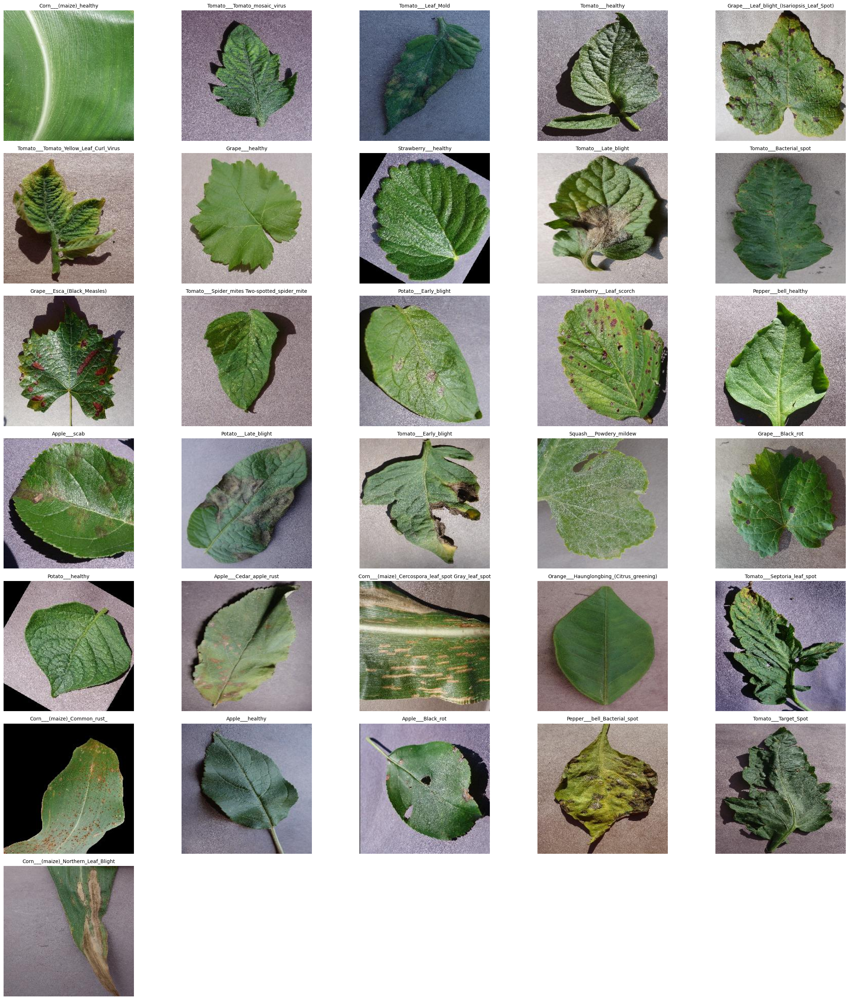

In [ ]:
# Show example train images
plt.figure(figsize=(25, 4 * ((len(list_train_dir) + 4) // 5)))

for row in range((len(list_train_dir) + 4) // 5):
    for col in range(5):
        idx = row * 5 + col
        if idx >= len(list_train_dir):
            break

        plt.subplot((len(list_train_dir) + 4) // 5, 5, idx + 1)

        class_dir = os.path.join(train_directory, list_train_dir[idx])
        img_path = os.path.join(class_dir, os.listdir(class_dir)[0])
        img = mpimg.imread(img_path)

        plt.imshow(img)
        plt.axis('off')
        plt.title(list_train_dir[idx], fontsize=10, wrap=True)

plt.tight_layout()
plt.show()

  # Validation Set

In [ ]:
# Define val image directory
# val_directory = '/content/drive/Shareddrives/Capstone Team_C242-PS112/ML/Plant Disease Dataset/PlantPal Dataset/Validation'
val_directory = path + '/Validation'

In [ ]:
# Define path
# val_path = '/content/drive/Shareddrives/Capstone Team_C242-PS112/ML/Plant Disease Dataset/PlantPal Dataset/Validation'
# os.listdir('/content/drive/Shareddrives/Capstone Team_C242-PS112/ML/Plant Disease Dataset/PlantPal Dataset/Validation')

val_path = val_directory
os.listdir(val_path)

['Corn___(maize)_healthy',
 'Tomato___Tomato_mosaic_virus',
 'Tomato___Leaf_Mold',
 'Tomato___healthy',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Grape___healthy',
 'Strawberry___healthy',
 'Tomato___Late_blight',
 'Tomato___Bacterial_spot',
 'Grape___Esca_(Black_Measles)',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Potato___Early_blight',
 'Pepper_bell___healthy',
 'Strawberry___Leaf_scorch',
 'Apple___scab',
 'Potato___Late_blight',
 'Tomato___Early_blight',
 'Squash___Powdery_mildew',
 'Grape___Black_rot',
 'Potato___healthy',
 'Apple___Cedar_apple_rust',
 'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Tomato___Septoria_leaf_spot',
 'Corn___(maize)_Common_rust_',
 'Pepper_bell___Bacterial_spot',
 'Apple___healthy',
 'Apple___Black_rot',
 'Tomato___Target_Spot',
 'Corn___(maize)_Northern_Leaf_Blight']

In [ ]:
# List directories in the specified path
list_val_dir = os.listdir(val_path)
print(list_val_dir)
print("Number of categories in validation set:", len(list_val_dir))

['Corn___(maize)_healthy', 'Tomato___Tomato_mosaic_virus', 'Tomato___Leaf_Mold', 'Tomato___healthy', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Grape___healthy', 'Strawberry___healthy', 'Tomato___Late_blight', 'Tomato___Bacterial_spot', 'Grape___Esca_(Black_Measles)', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Potato___Early_blight', 'Pepper_bell___healthy', 'Strawberry___Leaf_scorch', 'Apple___scab', 'Potato___Late_blight', 'Tomato___Early_blight', 'Squash___Powdery_mildew', 'Grape___Black_rot', 'Potato___healthy', 'Apple___Cedar_apple_rust', 'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot', 'Orange___Haunglongbing_(Citrus_greening)', 'Tomato___Septoria_leaf_spot', 'Corn___(maize)_Common_rust_', 'Pepper_bell___Bacterial_spot', 'Apple___healthy', 'Apple___Black_rot', 'Tomato___Target_Spot', 'Corn___(maize)_Northern_Leaf_Blight']
Number of categories in validation set: 31


In [ ]:
# show all diseases in dataset
diseases_val = os.listdir(val_directory)
print(diseases)

['Corn___(maize)_healthy', 'Tomato___Tomato_mosaic_virus', 'Tomato___Leaf_Mold', 'Tomato___healthy', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Grape___healthy', 'Strawberry___healthy', 'Tomato___Late_blight', 'Tomato___Bacterial_spot', 'Grape___Esca_(Black_Measles)', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Potato___Early_blight', 'Strawberry___Leaf_scorch', 'Pepper___bell_healthy', 'Apple___scab', 'Potato___Late_blight', 'Tomato___Early_blight', 'Squash___Powdery_mildew', 'Grape___Black_rot', 'Potato___healthy', 'Apple___Cedar_apple_rust', 'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot', 'Orange___Haunglongbing_(Citrus_greening)', 'Tomato___Septoria_leaf_spot', 'Corn___(maize)_Common_rust_', 'Apple___healthy', 'Apple___Black_rot', 'Pepper___bell_Bacterial_spot', 'Tomato___Target_Spot', 'Corn___(maize)_Northern_Leaf_Blight']


In [ ]:
# identify uniqe plant in dataset
plants = []
NumberOfDiseases = 0
for plant in diseases:
    if plant.split('___')[0] not in plants:
        plants.append(plant.split('___')[0])
print(f'number of different plants is :{len(plants)}')
print(plants)

number of different plants is :9
['Corn', 'Tomato', 'Grape', 'Strawberry', 'Potato', 'Pepper', 'Apple', 'Squash', 'Orange']


In [ ]:
# Iterate over the classes and print the number of images in each class folder
for item in list_val_dir:
    class_dir = os.path.join(val_directory, item)
    print(item, " : ", len(os.listdir(class_dir)), "images")

Corn___(maize)_healthy  :  465 images
Tomato___Tomato_mosaic_virus  :  448 images
Tomato___Leaf_Mold  :  470 images
Tomato___healthy  :  481 images
Grape___Leaf_blight_(Isariopsis_Leaf_Spot)  :  430 images
Tomato___Tomato_Yellow_Leaf_Curl_Virus  :  490 images
Grape___healthy  :  423 images
Strawberry___healthy  :  456 images
Tomato___Late_blight  :  463 images
Tomato___Bacterial_spot  :  425 images
Grape___Esca_(Black_Measles)  :  480 images
Tomato___Spider_mites Two-spotted_spider_mite  :  435 images
Potato___Early_blight  :  485 images
Pepper_bell___healthy  :  497 images
Strawberry___Leaf_scorch  :  444 images
Apple___scab  :  504 images
Potato___Late_blight  :  485 images
Tomato___Early_blight  :  480 images
Squash___Powdery_mildew  :  425 images
Grape___Black_rot  :  472 images
Potato___healthy  :  456 images
Apple___Cedar_apple_rust  :  440 images
Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot  :  410 images
Orange___Haunglongbing_(Citrus_greening)  :  503 images
Tomato___Sep

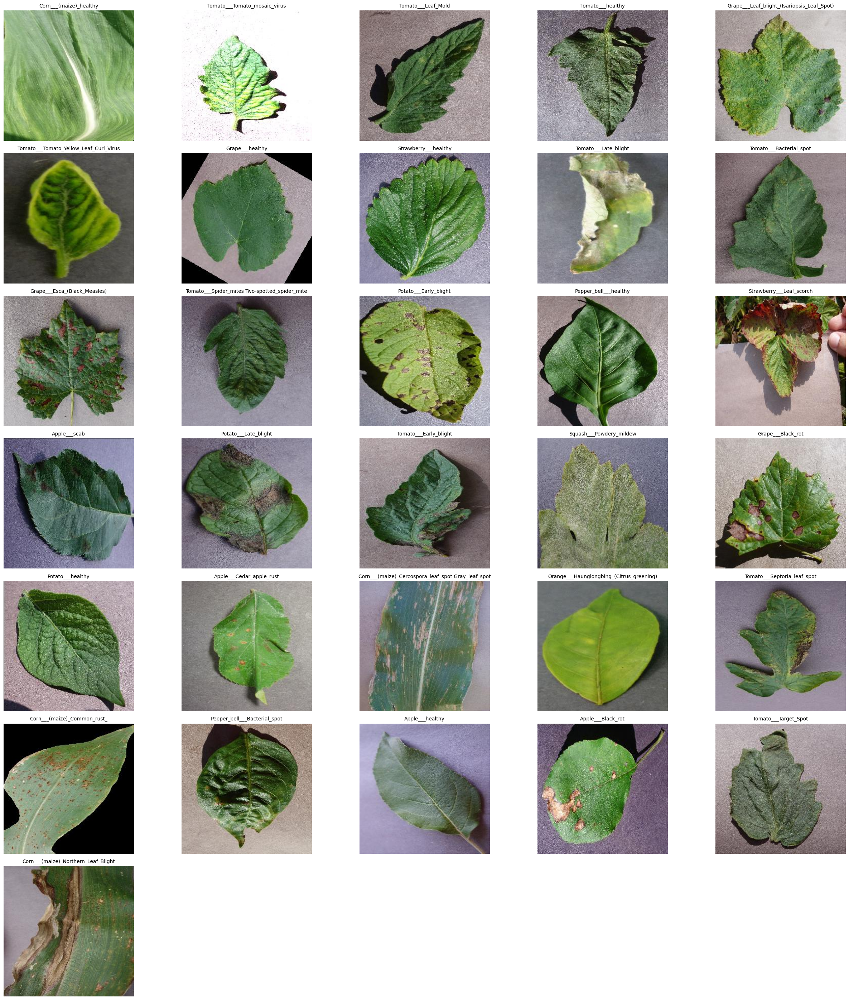

In [ ]:
# Show example train images
plt.figure(figsize=(25, 4 * ((len(list_val_dir) + 4) // 5)))

for row in range((len(list_val_dir) + 4) // 5):
    for col in range(5):
        idx = row * 5 + col
        if idx >= len(list_val_dir):
            break

        plt.subplot((len(list_val_dir) + 4) // 5, 5, idx + 1)

        class_dir = os.path.join(val_directory, list_val_dir[idx])
        img_path = os.path.join(class_dir, os.listdir(class_dir)[0])
        img = mpimg.imread(img_path)

        plt.imshow(img)
        plt.axis('off')
        plt.title(list_val_dir[idx], fontsize=10, wrap=True)

plt.tight_layout()
plt.show()

# Exploratory Data Analysis (EDA)

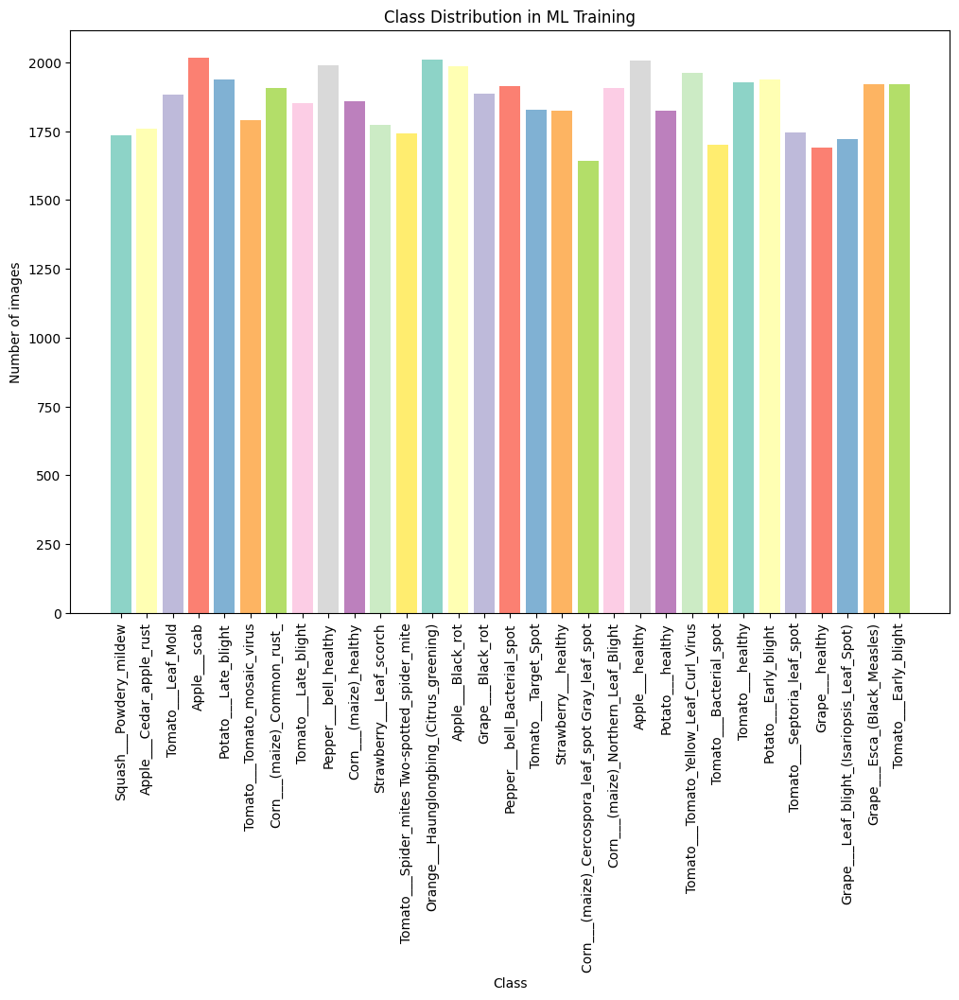

In [ ]:
import matplotlib.pyplot as plt
import os
import seaborn as sns

class_names = os.listdir(train_directory)
class_counts = {}

for class_name in class_names:
    class_counts[class_name] = len(os.listdir(os.path.join(train_directory, class_name)))

# Visualisasi distribusi kelas dengan palet warna yang diubah
plt.figure(figsize=(12, 8))

# Menggunakan palet warna Set3 dari seaborn
colors = sns.color_palette("Set3", len(class_counts))

plt.bar(class_counts.keys(), class_counts.values(), color=colors)
plt.xticks(rotation=90)
plt.title("Class Distribution in ML Training")
plt.xlabel("Class")
plt.ylabel("Number of images")
plt.show()

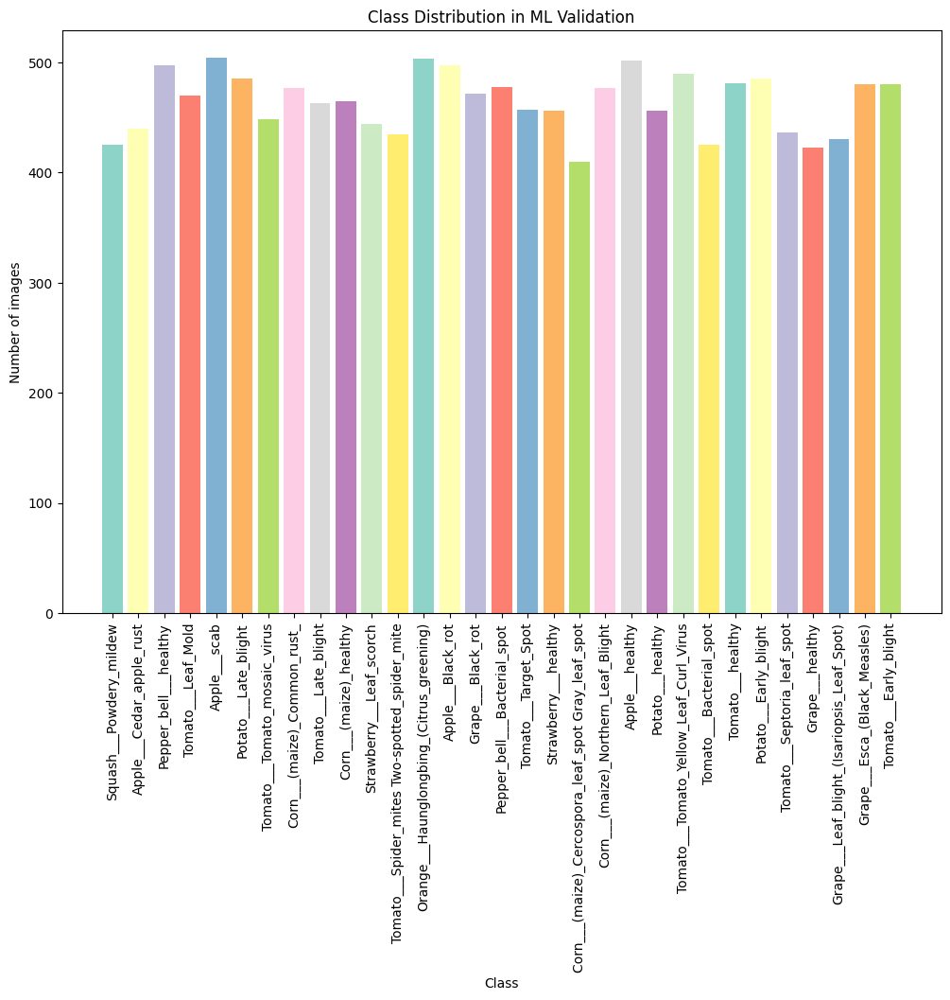

In [ ]:
# Define val image directory
# val_directory = '/content/drive/Shareddrives/Capstone Team_C242-PS112/ML/Plant Disease Dataset/PlantPal Dataset/Validation'

# Check class distribution in val_directory
val_class_names = os.listdir(val_directory)
val_class_counts = {}

for val_class_name in val_class_names:
    val_class_counts[val_class_name] = len(os.listdir(os.path.join(val_directory, val_class_name)))

# Visualize class distribution for val_directory
plt.figure(figsize=(12, 8))

# Use the same Set3 color palette for consistency
val_colors = sns.color_palette("Set3", len(val_class_counts))

plt.bar(val_class_counts.keys(), val_class_counts.values(), color=val_colors)
plt.xticks(rotation=90)
plt.title("Class Distribution in ML Validation")
plt.xlabel("Class")
plt.ylabel("Number of images")
plt.show()

# Preparation for Modelling

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def train_val_generators(TRAINING_DIR, VALIDATION_DIR):
    # Instantiate the ImageDataGenerator class for training
    train_datagen = ImageDataGenerator(rescale=1.0/255.,
                                       rotation_range=40,
                                       width_shift_range=0.2,
                                       height_shift_range=0.2,
                                       shear_range=0.2,
                                       zoom_range=0.2,
                                       horizontal_flip=True,
                                       fill_mode='nearest')

    # Flow training data from directory, resize images to (224, 224)
    train_generator = train_datagen.flow_from_directory(
        directory=TRAINING_DIR,
        batch_size=100,
        class_mode='categorical',
        target_size=(224, 224)  # Resize images to 224x224
    )

    # Instantiate the ImageDataGenerator class for validation
    validation_datagen = ImageDataGenerator(rescale=1.0/255.)

    # Flow validation data from directory, resize images to (224, 224)
    validation_generator = validation_datagen.flow_from_directory(
        directory=VALIDATION_DIR,
        batch_size=100,
        class_mode='categorical',
        shuffle=False,
        target_size=(224, 224)  # Resize images to 224x224
    )

    return train_generator, validation_generator

In [ ]:
# Define paths to the training and validation directories
TRAINING_DIR =  train_path
VALIDATION_DIR =  path + '/Validation'

# Get the generators
train_generator, validation_generator = train_val_generators(TRAINING_DIR, VALIDATION_DIR)

Found 57601 images belonging to 31 classes.
Found 14391 images belonging to 31 classes.


In [ ]:
# Extract labels
labels = []
for label in train_generator.class_indices:
    labels.append(label)

num_labels = len(labels)
print("Labels: {}".format(labels))

Found 57601 images belonging to 31 classes.
Found 14391 images belonging to 31 classes.
Training classes: {'Apple___Black_rot': 0, 'Apple___Cedar_apple_rust': 1, 'Apple___healthy': 2, 'Apple___scab': 3, 'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot': 4, 'Corn___(maize)_Common_rust_': 5, 'Corn___(maize)_Northern_Leaf_Blight': 6, 'Corn___(maize)_healthy': 7, 'Grape___Black_rot': 8, 'Grape___Esca_(Black_Measles)': 9, 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 10, 'Grape___healthy': 11, 'Orange___Haunglongbing_(Citrus_greening)': 12, 'Pepper___bell_Bacterial_spot': 13, 'Pepper___bell_healthy': 14, 'Potato___Early_blight': 15, 'Potato___Late_blight': 16, 'Potato___healthy': 17, 'Squash___Powdery_mildew': 18, 'Strawberry___Leaf_scorch': 19, 'Strawberry___healthy': 20, 'Tomato___Bacterial_spot': 21, 'Tomato___Early_blight': 22, 'Tomato___Late_blight': 23, 'Tomato___Leaf_Mold': 24, 'Tomato___Septoria_leaf_spot': 25, 'Tomato___Spider_mites Two-spotted_spider_mite': 26, 'Tomato___Target

In [ ]:
# Example to check the shape of one batch of images
x_batch, y_batch = next(train_generator)
print(f"Image batch shape: {x_batch.shape}")

In [ ]:
def plot_accuracy(history):

    plt.plot(history.history['accuracy'],label='train accuracy')
    plt.plot(history.history['val_accuracy'],label='validation accuracy')
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Accuracy_v1_InceptionV3')
    plt.show()

def plot_loss(history):

    plt.plot(history.history['loss'],label="train loss")
    plt.plot(history.history['val_loss'],label="validation loss")
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Loss_v1_InceptionV3')
    plt.show()

In [ ]:
def eval_CM(y_test, y_pred, labels):
    #Generate the confusion matrix
    cf_matrix3 = confusion_matrix(y_test, y_pred)

    ax3 = sns.heatmap(cf_matrix3, annot=True, fmt='g', cmap='Blues')

    ax3.set_title('Confusion Matrix with labels\n');
    ax3.set_xlabel('\nPredicted Values')
    ax3.set_ylabel('Actual Values ');

    ## Ticket labels - List must be in alphabetical order
    ax3.xaxis.set_ticklabels(labels, rotation=45)
    ax3.yaxis.set_ticklabels(labels, rotation=45)

    ## Display the visualization of the Confusion Matrix.
    return plt.show()

In [ ]:
def lest_predict(model, uploaded):
    img = image.load_img(uploaded, target_size=(224,224))
    imgplot = plt.imshow(img)
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    images = np.vstack([x])
    images /= 255 # because on train and test image is normalized, on image predict supposed to be too.
    classes = model.predict(images, batch_size=100) # the value is not always 1 and 0 because of probabilities
    predicted_class_indices=np.argmax(classes) # use to check prediction that have higher probabilities
    print(classes)
    print(labels[predicted_class_indices])

# CNN MODEL

In [ ]:
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import LeakyReLU

model = Sequential()

# Convolutional Layers with L2 Regularization and He Initialization
model.add(Conv2D(32, (3, 3), input_shape=(224, 224, 3), kernel_initializer='he_normal', kernel_regularizer=l2(0.0001)))
model.add(LeakyReLU(alpha=0.1))  # Use LeakyReLU to avoid dead neurons
model.add(Conv2D(32, (3, 3), kernel_initializer='he_normal', kernel_regularizer=l2(0.0001)))
model.add(LeakyReLU(alpha=0.1))
model.add(MaxPooling2D(2, 2))

model.add(Conv2D(64, (3, 3), kernel_initializer='he_normal', kernel_regularizer=l2(0.0001)))
model.add(LeakyReLU(alpha=0.1))
model.add(Conv2D(64, (3, 3), kernel_initializer='he_normal', kernel_regularizer=l2(0.0001)))
model.add(LeakyReLU(alpha=0.1))
model.add(MaxPooling2D(2, 2))

model.add(Conv2D(128, (3, 3), kernel_initializer='he_normal', kernel_regularizer=l2(0.0001)))
model.add(LeakyReLU(alpha=0.1))
model.add(Conv2D(128, (3, 3), kernel_initializer='he_normal', kernel_regularizer=l2(0.0001)))
model.add(LeakyReLU(alpha=0.1))
model.add(MaxPooling2D(2, 2))

# Replace Flatten with GlobalAveragePooling2D
model.add(GlobalAveragePooling2D())

# Dense Layers with Dropout and L2 Regularization
model.add(Dense(256, kernel_initializer='he_normal', kernel_regularizer=l2(0.0001)))
model.add(LeakyReLU(alpha=0.1))
model.add(BatchNormalization())
model.add(Dropout(0.2))  # Lower dropout rate

model.add(Dense(128, kernel_initializer='he_normal', kernel_regularizer=l2(0.0001)))
model.add(LeakyReLU(alpha=0.1))
model.add(BatchNormalization())
model.add(Dropout(0.2))

model.add(Dense(64, kernel_initializer='he_normal', kernel_regularizer=l2(0.0001)))
model.add(LeakyReLU(alpha=0.1))
model.add(BatchNormalization())
model.add(Dropout(0.2))

model.add(Dense(31, activation='softmax'))

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=tf.keras.optimizers.Adam(),
              metrics=['accuracy'])

# Model summary
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 222, 222, 32)      896       
                                                                 
 leaky_re_lu_9 (LeakyReLU)   (None, 222, 222, 32)      0         
                                                                 
 conv2d_7 (Conv2D)           (None, 220, 220, 32)      9248      
                                                                 
 leaky_re_lu_10 (LeakyReLU)  (None, 220, 220, 32)      0         
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 110, 110, 32)      0         
 g2D)                                                            
                                                                 
 conv2d_8 (Conv2D)           (None, 108, 108, 64)      18496     
                                                      

In [ ]:
from tensorflow.keras.callbacks import ReduceLROnPlateau

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-5, verbose=1)

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Ganti path berikut dengan path yang sesuai untuk sistem Anda
model_checkpoint_path = './saved_models/cnn_model.keras'  # Sesuaikan path ini

# Callbacks
model_checkpoint = ModelCheckpoint(model_checkpoint_path,
                                    monitor='val_accuracy',
                                    save_best_only=True,
                                    mode='max',
                                    verbose=1)

early_stopping = EarlyStopping(monitor='val_accuracy',
                               patience=3,
                               verbose=1,
                               mode='max',
                               restore_best_weights=True)

# Compile the model before training
model.compile(loss='categorical_crossentropy',
              optimizer=tf.keras.optimizers.Adam(),
              metrics=['accuracy'])

# Training the model
history = model.fit(train_generator,
                    validation_data=validation_generator,
                    epochs=25,
                    callbacks=[model_checkpoint, early_stopping])

Epoch 1/25
577/577 [==============================] - ETA: 0s - loss: 1.5678 - accuracy: 0.5698
Epoch 1: val_accuracy improved from -inf to 0.65624, saving model to ./saved_models/cnn_model.keras
577/577 [==============================] - 796s 1s/step - loss: 1.5678 - accuracy: 0.5698 - val_loss: 1.2668 - val_accuracy: 0.6562
Epoch 2/25
577/577 [==============================] - ETA: 0s - loss: 0.8293 - accuracy: 0.7895
Epoch 2: val_accuracy improved from 0.65624 to 0.79258, saving model to ./saved_models/cnn_model.keras
577/577 [==============================] - 792s 1s/step - loss: 0.8293 - accuracy: 0.7895 - val_loss: 0.7941 - val_accuracy: 0.7926
Epoch 3/25
577/577 [==============================] - ETA: 0s - loss: 0.6081 - accuracy: 0.8583
Epoch 3: val_accuracy improved from 0.79258 to 0.83441, saving model to ./saved_models/cnn_model.keras
577/577 [==============================] - 788s 1s/step - loss: 0.6081 - accuracy: 0.8583 - val_loss: 0.6670 - val_accuracy: 0.8344
Epoch 4/25

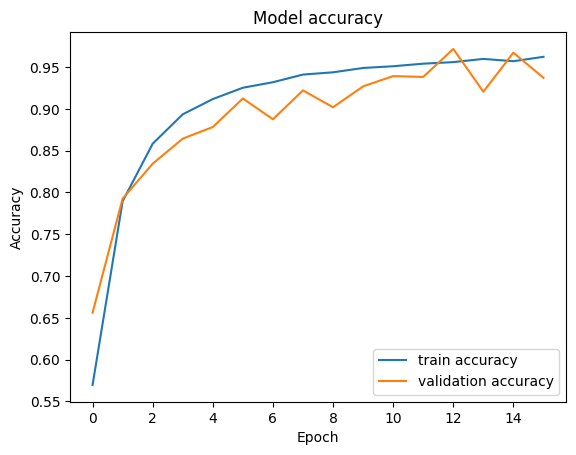

In [ ]:
# show learning curves
plot_accuracy(history)

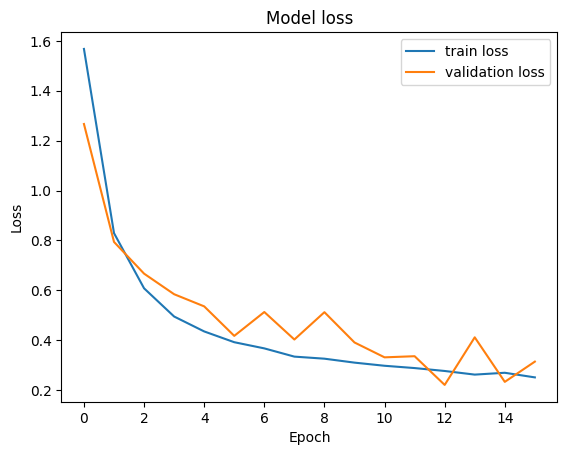

In [ ]:
plot_loss(history)

In [ ]:
import tensorflow as tf
from tensorflow.keras import backend as K

# Precision
def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

# Recall
def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

# F1 Score
def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2 * ((precision * recall) / (precision + recall + K.epsilon()))


In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score

# Prediksi data validasi
y_pred = model2.predict(validation_generator)
y_pred_classes = tf.argmax(y_pred, axis=1).numpy()  # Ambil label prediksi
y_true = validation_generator.classes  # Ambil label sebenarnya

# Hitung metrik
precision = precision_score(y_true, y_pred_classes, average='weighted')
recall = recall_score(y_true, y_pred_classes, average='weighted')
f1 = f1_score(y_true, y_pred_classes, average='weighted')

print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1 Score: {f1:.2f}")

144/144 [==============================] - 37s 258ms/step
Precision: 0.03
Recall: 0.04
F1 Score: 0.01


# Confusion Matrix

In [ ]:
def eval_CM(y_test, y_pred, labels):
    import matplotlib.pyplot as plt
    from sklearn.metrics import confusion_matrix
    import seaborn as sns

    # Generate the confusion matrix
    cf_matrix3 = confusion_matrix(y_test, y_pred)

    # Set up the matplotlib figure with a larger size for better readability
    plt.figure(figsize=(15, 12))  # Adjust figure size as needed

    ax3 = sns.heatmap(cf_matrix3, annot=True, fmt='g', cmap='Blues', cbar=True)

    ax3.set_title('Confusion Matrix with Labels\n')
    ax3.set_xlabel('\nPredicted Values')
    ax3.set_ylabel('Actual Values ')

    # Set tick labels - Make sure labels correspond to the order used in the confusion matrix
    ax3.xaxis.set_ticklabels(labels, rotation=45, ha='right')
    ax3.yaxis.set_ticklabels(labels, rotation=45)

    # Display the visualization of the Confusion Matrix
    return plt.show()

In [ ]:
y_test = validation_generator.classes
y_pred = model.predict(validation_generator)
y_pred = tf.argmax(y_pred, axis=1)

144/144 [==============================] - 39s 267ms/step


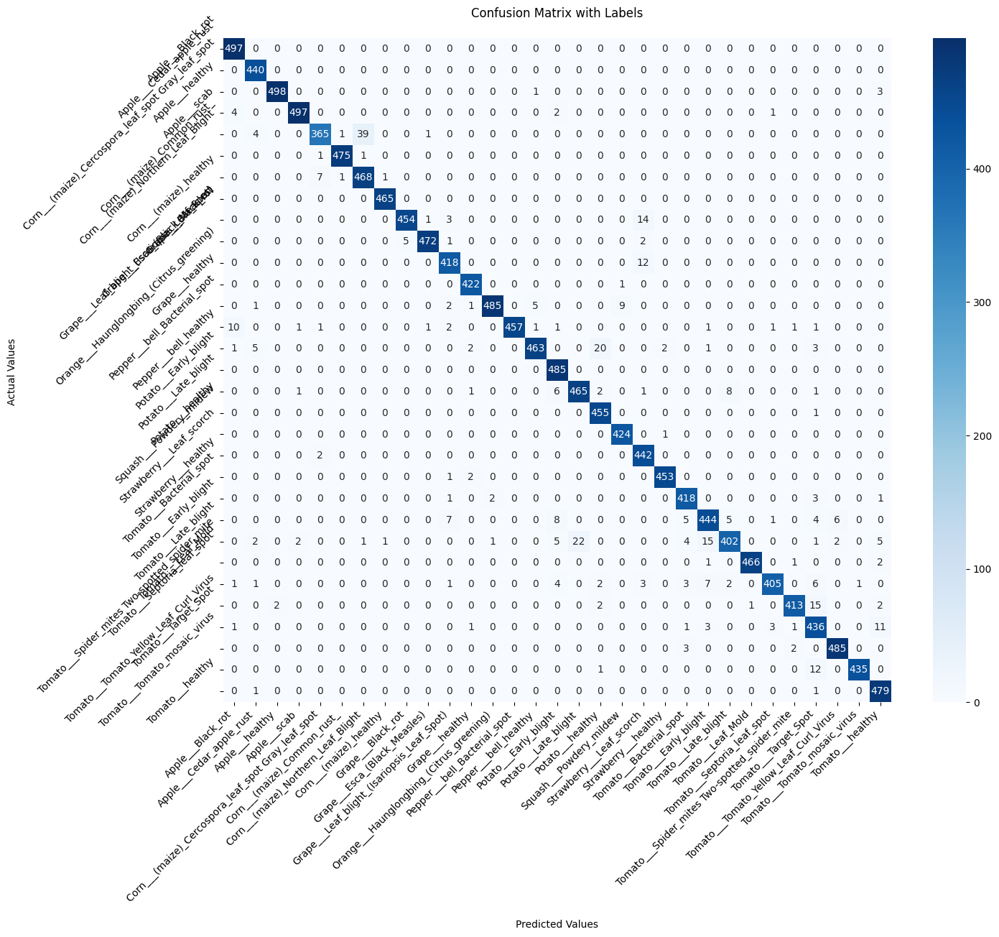

In [ ]:
eval_CM(y_test, y_pred, labels)

# TEST CNN MODEL

FileUpload(value={}, accept='image/*', description='Upload')

File 'TomatoYellowCurlVirus6.JPG' diunggah.


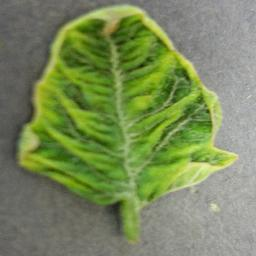

1/1 [==============================] - 0s 170ms/step
Prediksi:
Tomato___Tomato_Yellow_Leaf_Curl_Virus: 100.00%
Tomato___Bacterial_spot: 0.00%
Orange___Haunglongbing_(Citrus_greening): 0.00%
Tomato___Leaf_Mold: 0.00%
Pepper___bell_healthy: 0.00%
File '00cab05d-e87b-4cf6-87d8-284f3ec99626___FAM_B.Rot 3244_flipLR.JPG' diunggah.


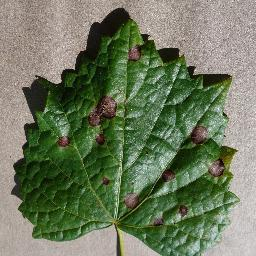

1/1 [==============================] - 0s 21ms/step
Prediksi:
Grape___Black_rot: 99.99%
Grape___Esca_(Black_Measles): 0.01%
Grape___healthy: 0.00%
Grape___Leaf_blight_(Isariopsis_Leaf_Spot): 0.00%
Apple___Black_rot: 0.00%
File '0d524d59-fb02-481b-9034-64f1de0da914___NREC_B.Spot 9060.JPG' diunggah.


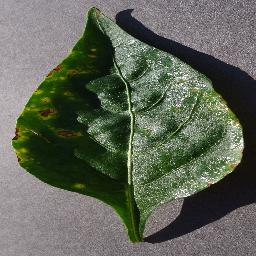

1/1 [==============================] - 0s 21ms/step
Prediksi:
Pepper___bell_Bacterial_spot: 99.99%
Tomato___Early_blight: 0.00%
Grape___Esca_(Black_Measles): 0.00%
Apple___Black_rot: 0.00%
Pepper___bell_healthy: 0.00%


In [ ]:
import tensorflow as tf
import numpy as np
from PIL import Image
from IPython.display import display
from ipywidgets import FileUpload


# **Daftar kelas**
class_names = ['Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Apple___scab',
              'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot', 'Corn___(maize)_Common_rust_',
              'Corn___(maize)_Northern_Leaf_Blight', 'Corn___(maize)_healthy', 'Grape___Black_rot',
              'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy',
              'Orange___Haunglongbing_(Citrus_greening)', 'Pepper___bell_Bacterial_spot', 'Pepper___bell_healthy',
              'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Squash___Powdery_mildew',
              'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight',
              'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot',
              'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot',
              'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy']

# **Fungsi untuk memproses gambar**
def preprocess_image(image_path, target_size=(224, 224)):  # Sesuaikan target_size dengan model Anda
    image = Image.open(image_path).convert("RGB")
    image = image.resize(target_size)
    img_array = np.array(image) / 255.0  # Normalisasi
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension
    return img_array

# **Fungsi untuk memprediksi kelas**
def predict_image(image_path):
    # Tampilkan gambar
    image = Image.open(image_path)
    display(image)

    # Preproses gambar
    img_array = preprocess_image(image_path)

    # Prediksi dengan model
    predictions = model.predict(img_array)[0]

    # Urutkan prediksi
    sorted_indices = np.argsort(predictions)[::-1]
    sorted_classes = [(class_names[i], predictions[i]) for i in sorted_indices]

    # Tampilkan hasil
    print("Prediksi:")
    for class_name, confidence in sorted_classes[:5]:  # Menampilkan 5 kelas teratas
        print(f"{class_name}: {confidence:.2%}")
    return sorted_classes

# **Unggah gambar untuk pengujian**
uploader = FileUpload(accept='image/*', multiple=False)

def on_upload_change(change):
    uploaded_file = next(iter(uploader.value.values()))
    file_name = uploaded_file['metadata']['name']
    with open(file_name, 'wb') as f:
        f.write(uploaded_file['content'])
    print(f"File '{file_name}' diunggah.")
    predict_image(file_name)

uploader.observe(on_upload_change, names='value')
display(uploader)

# SAVE CNN MODEL

In [ ]:
model.save('cnn_model_plantpal.h5')

In [ ]:
import tensorflow as tf
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

with open('cnn_model_plantpal.tflite', 'wb') as f:
    f.write(tflite_model)

print("Model telah berhasil disimpan sebagai model.tflite")

Model telah berhasil disimpan sebagai model.tflite


In [ ]:
model.save('plantpal_cnn_model.keras')

In [ ]:
# Save the model in SavedModel format
model.save('saved_model/plantpal_cnn_model')

In [ ]:
from google.colab import files
files.download('cnn_model_plantpal.h5')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Simpan history ke file menggunakan pickle
import pickle

with open('history.pkl', 'wb') as file:
    pickle.dump(history.history, file)

print("History saved to history.pkl")

History saved to history.pkl


# Converter CNN Model

In [ ]:
!tensorflowjs_converter --input_format=tf_saved_model /content/saved_model/plantpal_cnn_model /content/tfjs_cnn_model

2024-12-03 18:19:08.622614: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-03 18:19:08.622672: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-03 18:19:08.624889: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-03 18:19:09.696200: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2024-12-03 18:19:11.918483: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:47] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.


In [ ]:
!tensorflowjs_converter --input_format=keras cnn_model_plantpal.h5 /content/tfjs_cnn_model_from_h5

2024-12-03 12:57:36.885374: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-03 12:57:36.885436: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-03 12:57:36.887924: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-03 12:57:37.940605: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [ ]:
!zip -r models_cnn.zip /content/tfjs_cnn_model /content/saved_model /content/plantpal_cnn_model.h5 /content/plantpal_cnn_model.tflite /content/plantpal_cnn_model.keras /content/tfjs_cnn_model_from_h5 /content/history.pkl

	zip warning: name not matched: /content/plantpal_cnn_model.h5
	zip warning: name not matched: /content/plantpal_cnn_model.tflite
  adding: content/tfjs_cnn_model/ (stored 0%)
  adding: content/tfjs_cnn_model/model.json (deflated 91%)
  adding: content/tfjs_cnn_model/group1-shard1of1.bin (deflated 7%)
  adding: content/saved_model/ (stored 0%)
  adding: content/saved_model/plantpal_cnn_model/ (stored 0%)
  adding: content/saved_model/plantpal_cnn_model/variables/ (stored 0%)
  adding: content/saved_model/plantpal_cnn_model/variables/variables.index (deflated 70%)
  adding: content/saved_model/plantpal_cnn_model/variables/variables.data-00000-of-00001 (deflated 7%)
  adding: content/saved_model/plantpal_cnn_model/saved_model.pb (deflated 89%)
  adding: content/saved_model/plantpal_cnn_model/keras_metadata.pb (deflated 94%)
  adding: content/saved_model/plantpal_cnn_model/assets/ (stored 0%)
  adding: content/saved_model/plantpal_cnn_model/fingerprint.pb (stored 0%)
  adding: content/pla

In [ ]:
import os
from google.colab import files

files.download('models_cnn.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# MobileNet Model

In [ ]:
from tensorflow.keras.applications import MobileNet

# Load model MobileNet dengan bobot pretrained dari ImageNet
model1 = MobileNet(weights='imagenet')

# Menampilkan arsitektur model
model1.summary()

17225924/17225924 [==============================] - 0s 0us/step
Model: "mobilenet_1.00_224"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizati  (None, 112, 112, 32)      128       
 on)                                                             
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D  (None, 112, 112, 32)      288       
 )                                                               
                                                 

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.applications import MobileNet

# Load MobileNet tanpa output top (hanya bagian dasar model)
base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

base_model.trainable = True

# Hanya latih layer terakhir
for layer in base_model.layers[:-30]:
    layer.trainable = False

# Tambahkan layer baru
x = base_model.output
x = GlobalAveragePooling2D()(x)  # Pooling global
x = Dense(1024, activation='relu')(x)  # Fully connected layer
predictions = Dense(31, activation='softmax')(x)

# Membuat model baru
model2 = Model(inputs=base_model.input, outputs=predictions)

# Kompilasi model
model2.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Menampilkan arsitektur model
model2.summary()


Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizati  (None, 112, 112, 32)      128       
 on)                                                             
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D  (None, 112, 112, 32)      288       
 )                                                               
                                                                 
 conv_dw_1_bn (BatchNormali  (None, 112, 112, 32)      128 

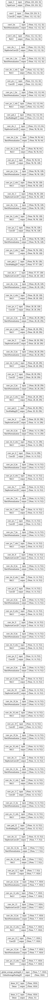

In [ ]:
from tensorflow.keras.utils import plot_model

plot_model(model2, show_shapes=True)

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

# Tambahkan callback untuk menyimpan model terbaik berdasarkan akurasi validasi
checkpoint = ModelCheckpoint('best_model_MobileNet.h5', monitor='val_accuracy', save_best_only=True, verbose=1)

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(monitor='val_loss', patience=5, verbose=1)

In [ ]:
history2 = model2.fit(
    train_generator,
    epochs=25,
    validation_data=validation_generator,
    callbacks=[checkpoint, early_stopping]
)

Epoch 1/25
577/577 [==============================] - ETA: 0s - loss: 0.1904 - accuracy: 0.9373
Epoch 1: val_accuracy improved from -inf to 0.91390, saving model to best_model_MobileNet.h5
577/577 [==============================] - 747s 1s/step - loss: 0.1904 - accuracy: 0.9373 - val_loss: 0.2901 - val_accuracy: 0.9139
Epoch 2/25
577/577 [==============================] - ETA: 0s - loss: 0.1079 - accuracy: 0.9661
Epoch 2: val_accuracy improved from 0.91390 to 0.96512, saving model to best_model_MobileNet.h5
577/577 [==============================] - 726s 1s/step - loss: 0.1079 - accuracy: 0.9661 - val_loss: 0.1170 - val_accuracy: 0.9651
Epoch 3/25
577/577 [==============================] - ETA: 0s - loss: 0.0817 - accuracy: 0.9740
Epoch 3: val_accuracy did not improve from 0.96512
577/577 [==============================] - 728s 1s/step - loss: 0.0817 - accuracy: 0.9740 - val_loss: 0.1864 - val_accuracy: 0.9483
Epoch 4/25
577/577 [==============================] - ETA: 0s - loss: 0.0786

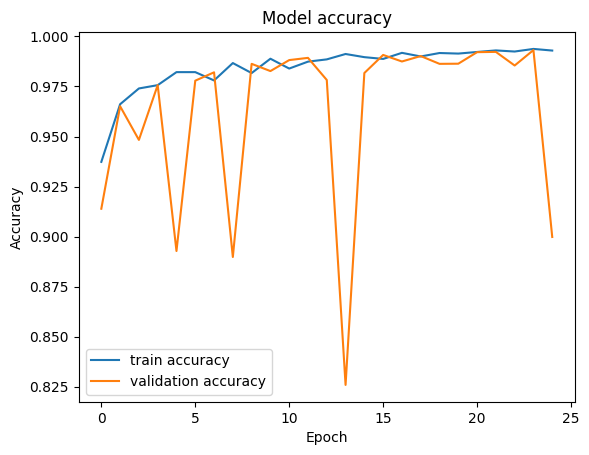

In [ ]:
# show learning curves
plot_accuracy(history2)

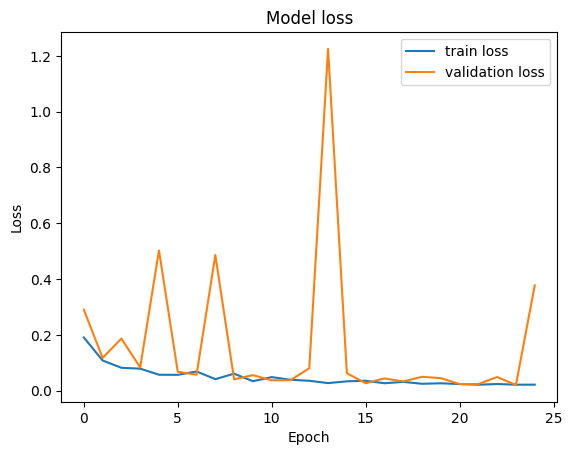

In [ ]:
plot_loss(history2)

In [ ]:
# Convert predictions to class indices
y_pred_mn = model2.predict(validation_generator)
print(f"Predictions shape: {y_pred_mn.shape}")

# Ensure correct dimensions for argmax
if len(y_pred_mn.shape) == 2:  # Multi-class
    y_pred_mn = tf.argmax(y_pred_mn, axis=1)
elif len(y_pred_mn.shape) == 1:  # Binary
    y_pred_mn = tf.round(y_pred_mn)
else:
    raise ValueError("Unexpected shape of predictions: ", y_pred_mn.shape)

# Convert predictions to numpy if needed
y_pred_mn = y_pred_mn.numpy()

144/144 [==============================] - 40s 280ms/step
Predictions shape: (14391, 31)


In [ ]:
y_pred

<tf.Tensor: shape=(14391,), dtype=int64, numpy=array([19, 14, 24, ..., 16,  5, 29])>

In [ ]:
# List to store predictions
y_pred_list = []

# Iterate through valid_data batch by batch
for images, labels in valid_data:
    # Predict for each batch of images
    y_pred_batch = model2.predict(images)

    # Append predictions to the list
    y_pred_list.append(y_pred_batch)

    # Optionally, break after processing a certain number of batches if needed
    # (e.g., stop after processing all images by checking the number of batches)
    if len(y_pred_list) * valid_data.batch_size >= len(valid_data.filenames):
        break

In [ ]:
# Convert list of predictions to a single array
y_pred = np.concatenate(y_pred_list, axis=0)

# Now y_pred is a 1D array of predictions corresponding to the images in valid_data

In [ ]:
# getthe real labels from valid_data
np.size(valid_data.classes)

14391

In [ ]:
valid_data.classes

array([ 0,  0,  0, ..., 30, 30, 30], dtype=int32)

In [ ]:
# Get the true labels
y_true = valid_data.classes

# Get the mapping of class names to numerical labels
class_indices = valid_data.class_indices
print(class_indices)

{'Apple___Black_rot': 0, 'Apple___Cedar_apple_rust': 1, 'Apple___healthy': 2, 'Apple___scab': 3, 'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot': 4, 'Corn___(maize)_Common_rust_': 5, 'Corn___(maize)_Northern_Leaf_Blight': 6, 'Corn___(maize)_healthy': 7, 'Grape___Black_rot': 8, 'Grape___Esca_(Black_Measles)': 9, 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 10, 'Grape___healthy': 11, 'Orange___Haunglongbing_(Citrus_greening)': 12, 'Pepper_bell___Bacterial_spot': 13, 'Pepper_bell___healthy': 14, 'Potato___Early_blight': 15, 'Potato___Late_blight': 16, 'Potato___healthy': 17, 'Squash___Powdery_mildew': 18, 'Strawberry___Leaf_scorch': 19, 'Strawberry___healthy': 20, 'Tomato___Bacterial_spot': 21, 'Tomato___Early_blight': 22, 'Tomato___Late_blight': 23, 'Tomato___Leaf_Mold': 24, 'Tomato___Septoria_leaf_spot': 25, 'Tomato___Spider_mites Two-spotted_spider_mite': 26, 'Tomato___Target_Spot': 27, 'Tomato___Tomato_Yellow_Leaf_Curl_Virus': 28, 'Tomato___Tomato_mosaic_virus': 29, 'Tomato___he

In [ ]:
labels = []
for label in train_data.class_indices:
  labels.append(label)
num_labels = len(labels)

print("Labels: {}".format(labels))

Labels: ['Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Apple___scab', 'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot', 'Corn___(maize)_Common_rust_', 'Corn___(maize)_Northern_Leaf_Blight', 'Corn___(maize)_healthy', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Pepper___bell_Bacterial_spot', 'Pepper___bell_healthy', 'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy']


# Confusion Matrix

In [ ]:
def eval_CM(y_test, y_pred_mn, labels):
    import matplotlib.pyplot as plt
    from sklearn.metrics import confusion_matrix
    import seaborn as sns

    # Generate the confusion matrix
    cf_matrix3 = confusion_matrix(y_test, y_pred_mn)

    # Set up the matplotlib figure with a larger size for better readability
    plt.figure(figsize=(15, 12))  # Adjust figure size as needed

    ax3 = sns.heatmap(cf_matrix3, annot=True, fmt='g', cmap='Blues', cbar=True)

    ax3.set_title('Confusion Matrix with Labels\n')
    ax3.set_xlabel('\nPredicted Values')
    ax3.set_ylabel('Actual Values ')

    # Set tick labels - Make sure labels correspond to the order used in the confusion matrix
    ax3.xaxis.set_ticklabels(labels, rotation=45, ha='right')
    ax3.yaxis.set_ticklabels(labels, rotation=45)

    # Display the visualization of the Confusion Matrix
    return plt.show()

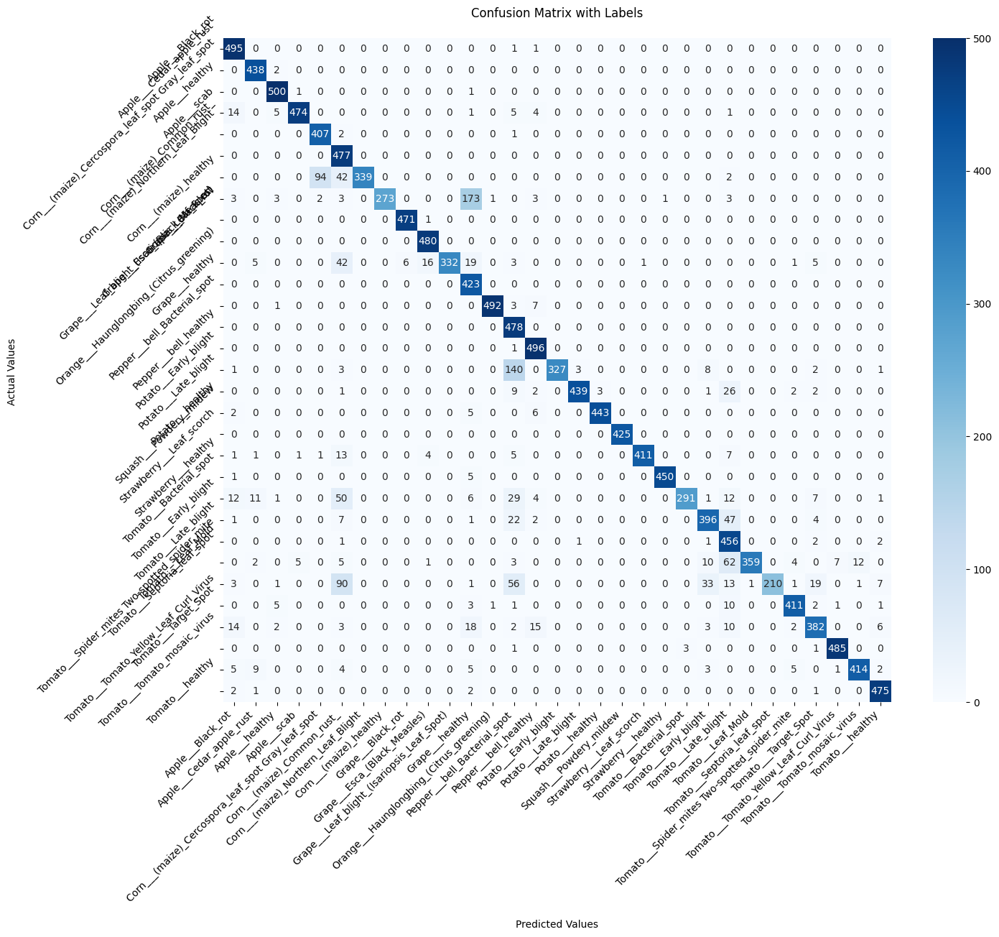

In [ ]:
eval_CM(y_test, y_pred_mn, labels)

# Test Model

FileUpload(value={}, accept='image/*', description='Upload')

File '00b65fe8-cee1-4b68-8ef4-1211814f2845___FAM_B.Msls 3990.JPG' diunggah.


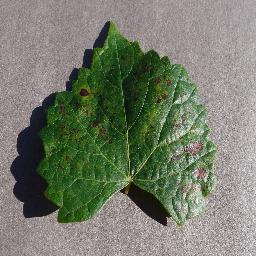

1/1 [==============================] - 0s 493ms/step
Prediksi:
Grape___Esca_(Black_Measles): 100.00%
Grape___Black_rot: 0.00%
Corn___(maize)_Common_rust_: 0.00%
Apple___Cedar_apple_rust: 0.00%
Grape___healthy: 0.00%
File '0a1a49a8-3a95-415a-b115-4d6d136b980b___R.S_HL 8216 copy_flipLR.jpg' diunggah.


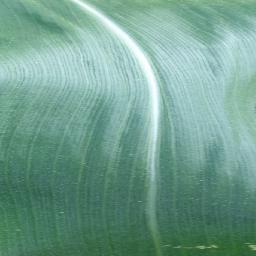

1/1 [==============================] - 0s 25ms/step
Prediksi:
Grape___healthy: 64.13%
Corn___(maize)_healthy: 26.73%
Apple___healthy: 5.98%
Tomato___Late_blight: 0.79%
Tomato___healthy: 0.79%
File '0a47f32c-1724-4c8d-bfe4-986cedd3587b___RS_Early.B 8001.JPG' diunggah.


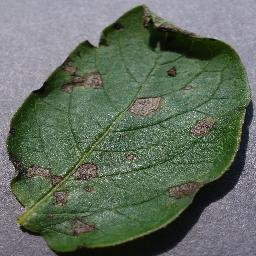

1/1 [==============================] - 0s 21ms/step
Prediksi:
Potato___Early_blight: 100.00%
Pepper___bell_Bacterial_spot: 0.00%
Apple___Black_rot: 0.00%
Tomato___Early_blight: 0.00%
Tomato___Septoria_leaf_spot: 0.00%


In [ ]:
import tensorflow as tf
import numpy as np
from PIL import Image
from IPython.display import display
from ipywidgets import FileUpload


# **Daftar kelas**
class_names = ['Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Apple___scab',
              'Corn___(maize)_Cercospora_leaf_spot Gray_leaf_spot', 'Corn___(maize)_Common_rust_',
              'Corn___(maize)_Northern_Leaf_Blight', 'Corn___(maize)_healthy', 'Grape___Black_rot',
              'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy',
              'Orange___Haunglongbing_(Citrus_greening)', 'Pepper___bell_Bacterial_spot', 'Pepper___bell_healthy',
              'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Squash___Powdery_mildew',
              'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight',
              'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot',
              'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot',
              'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy']

# **Fungsi untuk memproses gambar**
def preprocess_image(image_path, target_size=(224, 224)):  # Sesuaikan target_size dengan model Anda
    image = Image.open(image_path).convert("RGB")
    image = image.resize(target_size)
    img_array = np.array(image) / 255.0  # Normalisasi
    img_array = np.expand_dims(img_array, axis=0)  # Menambahkan batch dimension
    return img_array

# **Fungsi untuk memprediksi kelas**
def predict_image(image_path):
    # Tampilkan gambar
    image = Image.open(image_path)
    display(image)

    # Preproses gambar
    img_array = preprocess_image(image_path)

    # Prediksi dengan model
    predictions = model2.predict(img_array)[0]

    # Urutkan prediksi
    sorted_indices = np.argsort(predictions)[::-1]
    sorted_classes = [(class_names[i], predictions[i]) for i in sorted_indices]

    # Tampilkan hasil
    print("Prediksi:")
    for class_name, confidence in sorted_classes[:5]:  # Menampilkan 5 kelas teratas
        print(f"{class_name}: {confidence:.2%}")
    return sorted_classes

# **Unggah gambar untuk pengujian**
uploader = FileUpload(accept='image/*', multiple=False)

def on_upload_change(change):
    uploaded_file = next(iter(uploader.value.values()))
    file_name = uploaded_file['metadata']['name']
    with open(file_name, 'wb') as f:
        f.write(uploaded_file['content'])
    print(f"File '{file_name}' diunggah.")
    predict_image(file_name)

uploader.observe(on_upload_change, names='value')
display(uploader)

# Save Model

In [ ]:
# Simpan history2 ke file menggunakan pickle
import pickle

with open('history2.pkl', 'wb') as file:
    pickle.dump(history2.history, file)

print("History saved to history2.pkl")

History saved to history2.pkl


In [ ]:
# Konversi model Keras ke format TFLite
converter = tf.lite.TFLiteConverter.from_keras_model(model2)
tflite_model = converter.convert()

# Simpan sebagai file .tflite
with open("plantpal_model.tflite", "wb") as tflite_file:
    tflite_file.write(tflite_model)

In [ ]:
model2.save('plantpal_model.keras')

In [ ]:
# Save the model in SavedModel format
model2.save('saved_model/plantpal_model')

In [ ]:
# Menyimpan model sebagai file.h5
model2.save('plantpal_model.h5')

In [ ]:
# Mendownload model jika menggunakan Google Colab
files.download('plantpal_model.h5')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Check

In [ ]:
!ls -R /root/.cache/

In [ ]:
print(os.getcwd())

/content


In [ ]:
# new_model = keras.models.load_model('plantpal_model.keras')

In [ ]:
# Load the model from SavedModel format
# new_model = keras.models.load_model('saved_model/plantpal_model')

### Konversi

In [ ]:
!tensorflowjs_converter --input_format=tf_saved_model /content/saved_model/plantpal_model /content/tfjs_model

2024-12-03 18:36:01.638898: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-03 18:36:01.638958: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-03 18:36:01.640657: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-03 18:36:02.729847: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2024-12-03 18:36:05.037938: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:47] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.


In [ ]:
!tensorflowjs_converter --input_format=keras plantpal_model.h5 /content/tfjs_model_from_h5

2024-12-03 18:36:51.862938: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-03 18:36:51.862992: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-03 18:36:51.864447: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-03 18:36:52.969990: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [ ]:
!zip -r models.zip /content/tfjs_model /content/saved_model /content/plantpal_model.h5 /content/plantpal_model.tflite /content/plantpal_model.keras /content/tfjs_model_from_h5 /content/history2.pkl

updating: content/saved_model/ (stored 0%)
updating: content/saved_model/plantpal_cnn_model/ (stored 0%)
updating: content/saved_model/plantpal_cnn_model/variables/ (stored 0%)
updating: content/saved_model/plantpal_cnn_model/variables/variables.index (deflated 70%)
updating: content/saved_model/plantpal_cnn_model/variables/variables.data-00000-of-00001 (deflated 7%)
updating: content/saved_model/plantpal_cnn_model/saved_model.pb (deflated 89%)
updating: content/saved_model/plantpal_cnn_model/keras_metadata.pb (deflated 94%)
updating: content/saved_model/plantpal_cnn_model/assets/ (stored 0%)
updating: content/saved_model/plantpal_cnn_model/fingerprint.pb (stored 0%)
  adding: content/tfjs_model/ (stored 0%)
  adding: content/tfjs_model/group1-shard3of5.bin (deflated 7%)
  adding: content/tfjs_model/group1-shard1of5.bin (deflated 7%)
  adding: content/tfjs_model/group1-shard4of5.bin (deflated 7%)
  adding: content/tfjs_model/group1-shard5of5.bin (deflated 7%)
  adding: content/tfjs_mod

In [ ]:
import os
from google.colab import files

files.download('models_plantpal.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>